In [ ]:
# Install necessary packages and libraries
!pip install transformers -q
!pip install nltk
!pip install pycocotools
!pip install --upgrade nltk
import nltk
nltk.download('punkt')
nltk.download('wordnet')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 71.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.8/294.8 kB 25.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 114.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 81.7 MB/s eta 0:00:00


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
# Import required libraries
from transformers import pipeline
import zipfile
import os
import pandas as pd
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from IPython.display import display
from nltk.translate import meteor_score
from nltk.tokenize import word_tokenize
from tensorflow.keras.preprocessing.image import load_img, img_to_array

In [ ]:
#mount google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Set up an image captioning pipeline using the Hugging Face Transformers library
image_caption = pipeline(
    "image-to-text",
    model="Salesforce/blip-image-captioning-base"
)


In [ ]:
# Extract the flickr8k_Dataset folder
zip_path = '/content/drive/MyDrive/transformer_model/Flickr8k_Dataset (1).zip'
extract_folder = '/content/drive/MyDrive/transformer_model'

with zipfile.ZipFile(zip_path, 'r') as zipImage:
    zipImage.extractall(extract_folder)


In [ ]:
# Path to the caption file
dir_Flickr_text = '/content/drive/MyDrive/Image captioning/captions/Flickr8k.token.txt'


In [ ]:
 #Path to image file
image_path = '/content/drive/MyDrive/transformer_model/Flicker8k_Dataset/'
# List of image filenames
jpgs = os.listdir(image_path)

# Print total number of images in the dataset
print("Total Images in Dataset =", len(jpgs))

Total Images in Dataset = 8091


In [ ]:
# Open the Flickr text file and read its content
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

# Initialize an empty list to store processed caption data
datatxt = []

# Iterate through each line in the text content
for line in text.split('\n'):
    col = line.split('\t')
    # Check if the line has only one column
    if len(col) == 1:
        continue
    # Split the first column by "#" symbol
    w = col[0].split("#")
    # Append the processed data to the list
    datatxt.append(w + [col[1].lower()])

# Create a DataFrame from the processed caption data
data = pd.DataFrame(datatxt, columns=["filename","index","caption"])

# Reindex the columns of the DataFrame
data = data.reindex(columns=['index','filename','caption'])

# Remove rows with a specific filename value from the DataFrame
data = data[data.filename != '2258277193_586949ec62.jpg.1']

# Get unique filenames from the DataFrame
uni_filenames = np.unique(data.filename.values)

# Display the first few rows of the DataFrame
data.head()  # This line displays the initial rows of the DataFrame


,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


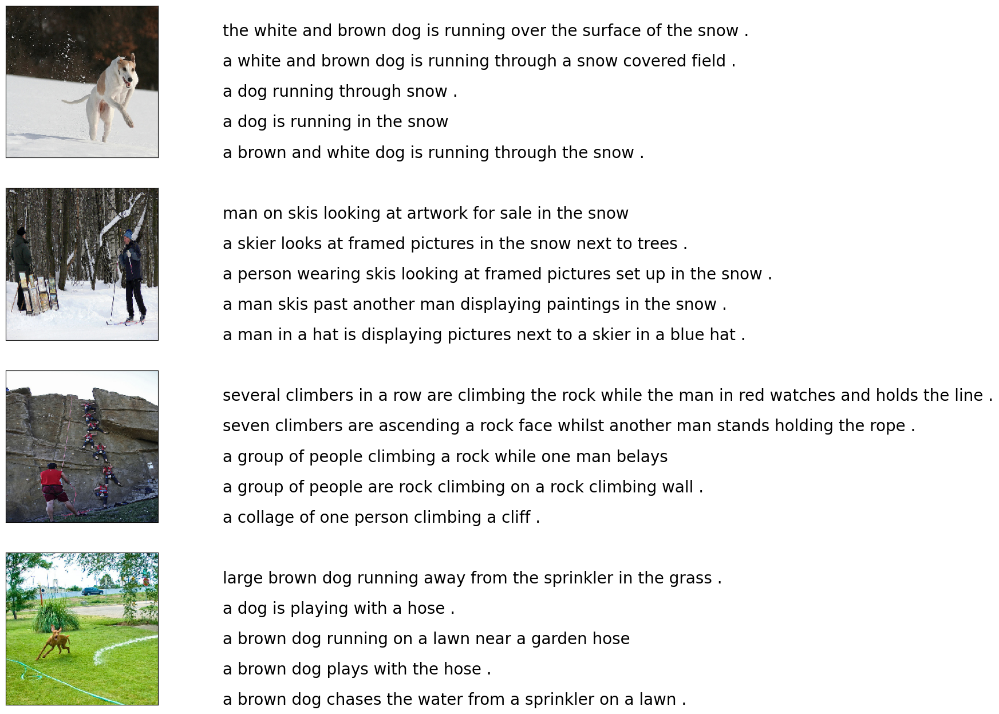

In [ ]:
# Define the number of images to display and their target size
npic = 5
npix = 224
target_size = (npix, npix, 3)

# Initialize a counter for plotting
count = 1

# Create a figure to display images and captions
fig = plt.figure(figsize=(10, 20))

# Iterate through a subset of unique filenames
for file in uni_filenames[10:14]:
   # Construct the full path of the image file
   filename = image_path + '/' + file

   # Extract captions associated with the current filename
   captions = list(data["caption"].loc[data["filename"] == file].values)

   # Load and display the image
   image_load = load_img(filename, target_size=target_size)
   ax = fig.add_subplot(npic, 2, count, xticks=[], yticks=[])
   ax.imshow(image_load)
   count += 1

   # Create a subplot for displaying captions
   ax = fig.add_subplot(npic, 2, count)
   plt.axis('off')
   ax.plot()
   ax.set_xlim(0, 1)
   ax.set_ylim(0, len(captions))

   # Add captions to the subplot
   for i, caption in enumerate(captions):
       ax.text(0, i, caption, fontsize=20)
   count += 1

# Show the figure with images and captions
plt.show()


In [ ]:
# Define the path to the folder containing image files
folder_path = '/content/drive/MyDrive/transformer_model/Flicker8k_Dataset'

# Create a list of complete image file paths using list comprehension
complete_image_files = [f"{folder_path}/{filename}" for filename in uni_filenames]

# Append the complete image file paths to the existing list of unique filenames
uni_filenames += complete_image_files

In [ ]:
# Load the random_image_datset.csv file into a DataFrame
csv_file_path = '/content/drive/MyDrive/random_images_data (1).csv'  # Replace with the actual path to your CSV file
random_testimage_df = pd.read_csv(csv_file_path)

In [ ]:
random_testimage_df

,Image_ID,Image_Path,Actual_Caption
0,2867937005_91c092b157,/content/drive/MyDrive/attention_model/Flicker...,<start> girl in pick dress stands upside down ...
1,226607225_44d696db6b,/content/drive/MyDrive/attention_model/Flicker...,<start> the large green fish is jumping out of...
2,481054596_cad8c02103,/content/drive/MyDrive/attention_model/Flicker...,<start> the man in the red shirt is taking pic...
3,3044500219_778f9f2b71,/content/drive/MyDrive/attention_model/Flicker...,<start> four girls in evening wear are posing ...
4,508929192_670910fdd2,/content/drive/MyDrive/attention_model/Flicker...,<start> children are playing badminton in the ...
5,284279868_2ca98e3dcd,/content/drive/MyDrive/attention_model/Flicker...,<start> two dogs play in field of snow <end>
6,1775029934_e1e96038a8,/content/drive/MyDrive/attention_model/Flicker...,<start> an <unk> runs through tall brown grass...
7,2358554995_54ed3baa83,/content/drive/MyDrive/attention_model/Flicker...,<start> child is holding on to the top of play...
8,3262760716_1e9734f5ba,/content/drive/MyDrive/attention_model/Flicker...,<start> man holds baby which is chewing on eye...
9,2450299735_62c095f40e,/content/drive/MyDrive/attention_model/Flicker...,<start> little girl in white shirt sliding dow...


In [ ]:
from nltk.translate.bleu_score import sentence_bleu

Image ID: 2867937005_91c092b157
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2867937005_91c092b157.jpg
Actual Caption: <start> girl in pick dress stands upside down <end>
Predicted_caption: <start> a little girl laying on a couch wearing a pink tutue <end>


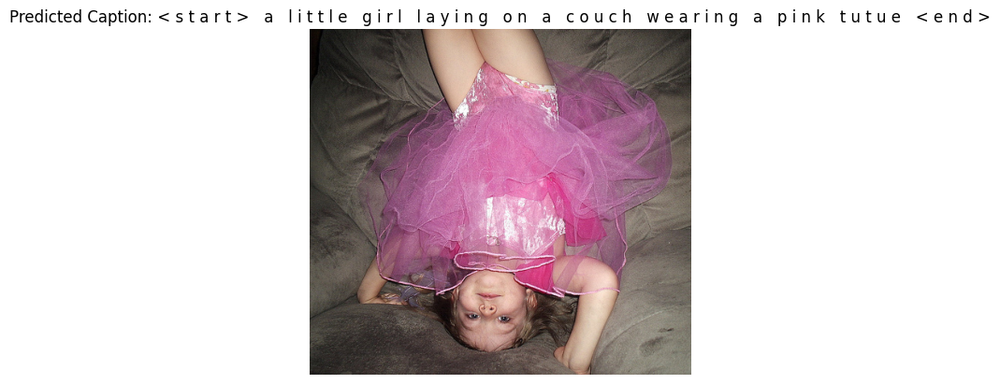

METEOR score for Image 1: 0.5018275967103258
BLEU score as percentage: 0.00%
------------------------------
Image ID: 226607225_44d696db6b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/226607225_44d696db6b.jpg
Actual Caption: <start> the large green fish is jumping out of the water <end>
Predicted_caption: <start> a fish jumping out of the water <end>


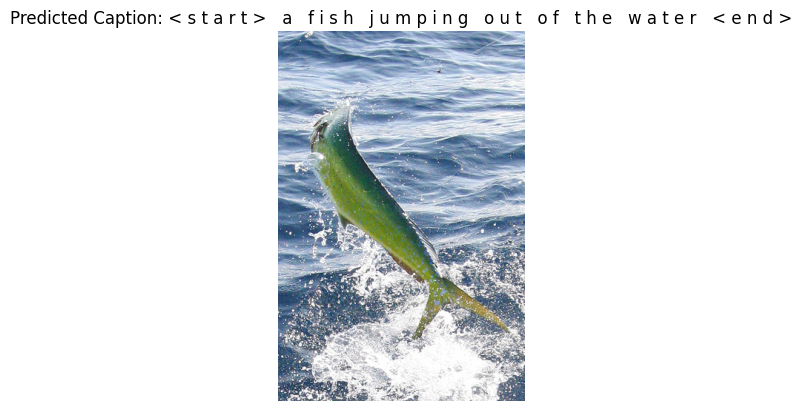

METEOR score for Image 2: 0.7583598726114649
BLEU score as percentage: 54.39%
------------------------------
Image ID: 481054596_cad8c02103
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/481054596_cad8c02103.jpg
Actual Caption: <start> the man in the red shirt is taking picture of the two people hugging <end>
Predicted_caption: <start> a group of people walking around a city square <end>


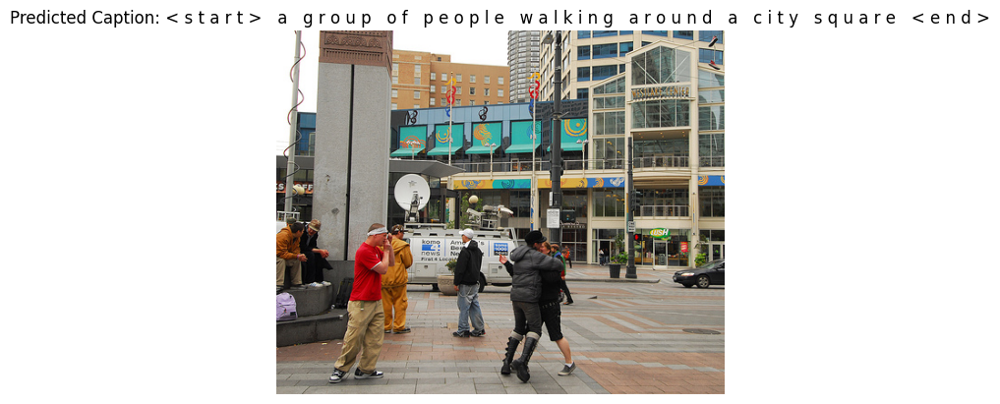

METEOR score for Image 3: 0.3846153846153846
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3044500219_778f9f2b71
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3044500219_778f9f2b71.jpg
Actual Caption: <start> four girls in evening wear are posing for photograph <end>
Predicted_caption: <start> three women posing for a picture <end>


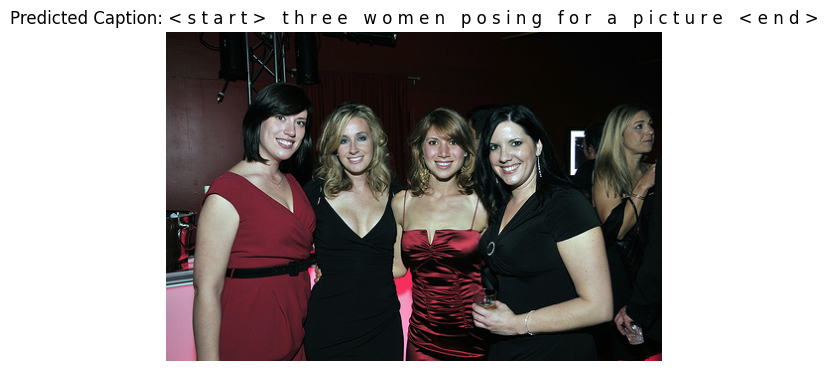

METEOR score for Image 4: 0.5298681972789115
BLEU score as percentage: 0.00%
------------------------------
Image ID: 508929192_670910fdd2
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/508929192_670910fdd2.jpg
Actual Caption: <start> children are playing badminton in the garden <end>
Predicted_caption: <start> two boys playing with a frck <end>


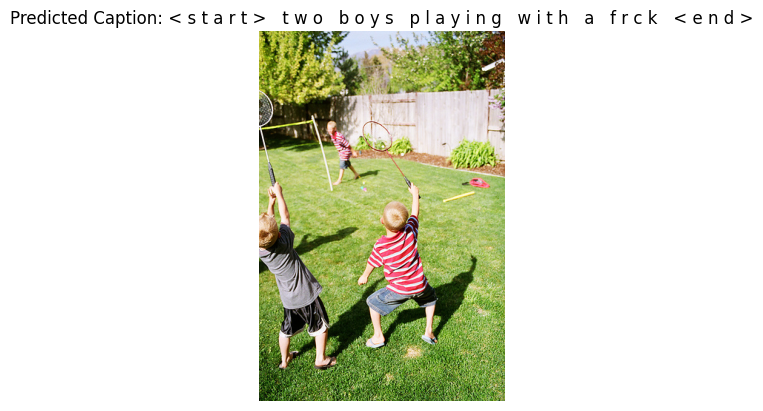

METEOR score for Image 5: 0.5212782787533617
BLEU score as percentage: 0.00%
------------------------------
Image ID: 284279868_2ca98e3dcd
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/284279868_2ca98e3dcd.jpg
Actual Caption: <start> two dogs play in field of snow <end>
Predicted_caption: <start> two dogs playing in the snow <end>


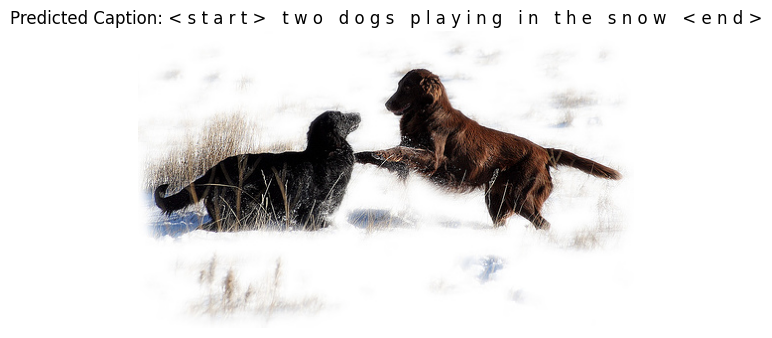

METEOR score for Image 6: 0.8501505541674674
BLEU score as percentage: 50.17%
------------------------------
Image ID: 1775029934_e1e96038a8
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1775029934_e1e96038a8.jpg
Actual Caption: <start> an <unk> runs through tall brown grass <end>
Predicted_caption: <start> a blue sky <end>


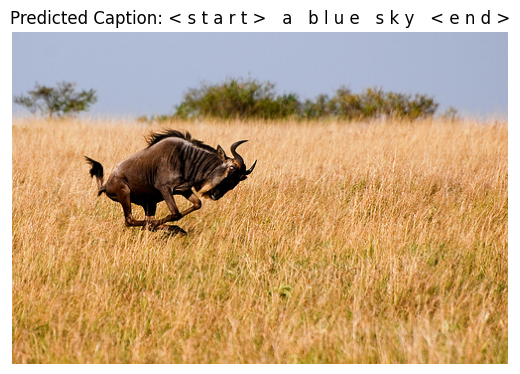

METEOR score for Image 7: 0.35493827160493824
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2358554995_54ed3baa83
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2358554995_54ed3baa83.jpg
Actual Caption: <start> child is holding on to the top of playground slide <end>
Predicted_caption: <start> a young boy sitting on a slide <end>


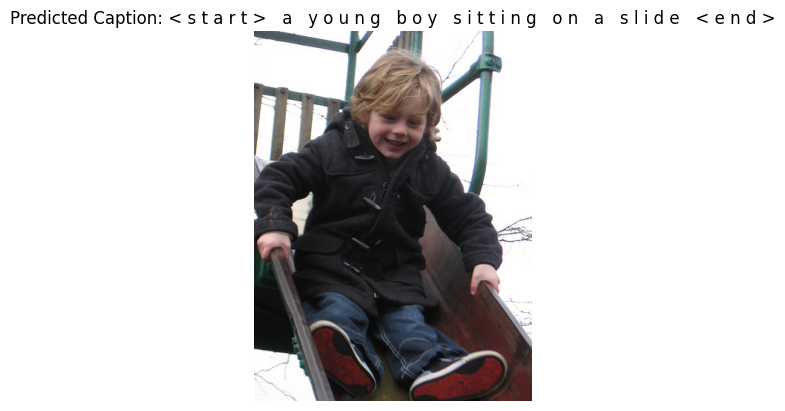

METEOR score for Image 8: 0.4961186305732484
BLEU score as percentage: 22.96%
------------------------------
Image ID: 3262760716_1e9734f5ba
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3262760716_1e9734f5ba.jpg
Actual Caption: <start> man holds baby which is chewing on eyeglasses <end>
Predicted_caption: <start> a man holding a baby <end>


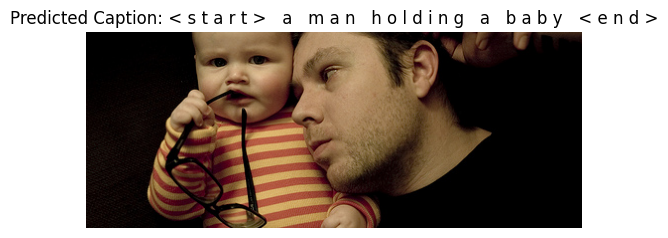

METEOR score for Image 9: 0.6280976840587548
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2450299735_62c095f40e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2450299735_62c095f40e.jpg
Actual Caption: <start> little girl in white shirt sliding down green slide splashing into blue baby pool <end>
Predicted_caption: <start> a little girl in a pool <end>


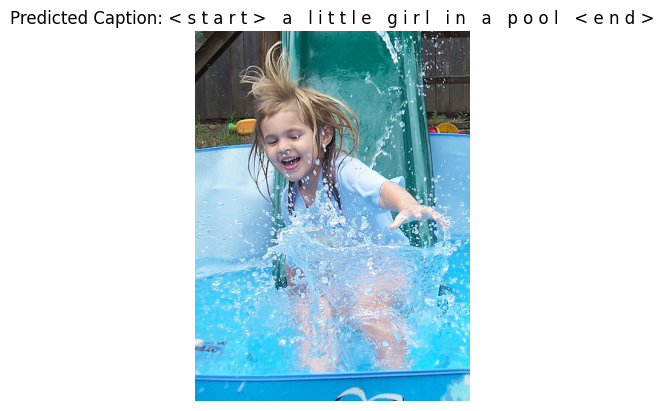

METEOR score for Image 10: 0.5138020833333334
BLEU score as percentage: 20.12%
------------------------------
Image ID: 3449718979_e987c64e2d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3449718979_e987c64e2d.jpg
Actual Caption: <start> brown dog is walking down steps <end>
Predicted_caption: <start> a dog running up a set of stairs <end>


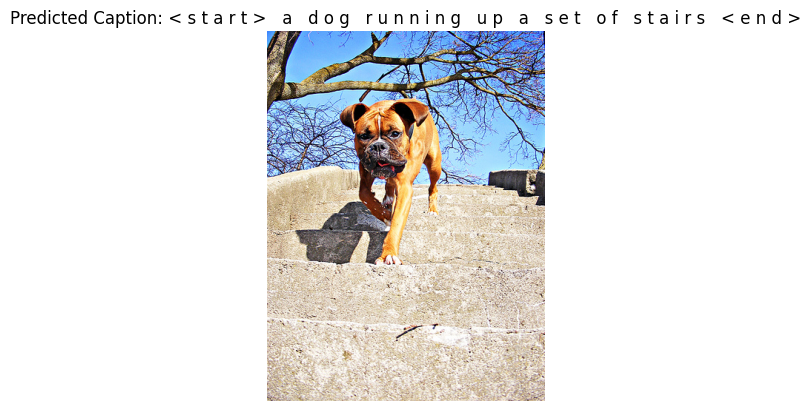

METEOR score for Image 11: 0.6384477459016394
BLEU score as percentage: 0.00%
------------------------------
Image ID: 436009777_440c7679a1
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/436009777_440c7679a1.jpg
Actual Caption: <start> two people sitting on rock in city park <end>
Predicted_caption: <start> a person sitting on a rock <end>


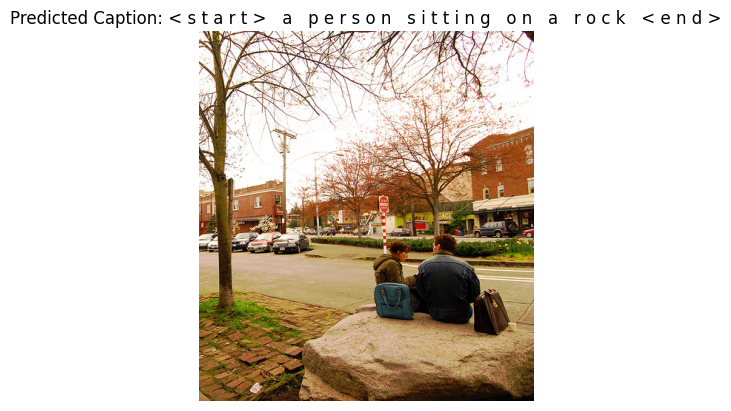

METEOR score for Image 12: 0.6235462515655753
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2618538137_44fffe10c4
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2618538137_44fffe10c4.jpg
Actual Caption: <start> man on skateboard poses with dog <end>
Predicted_caption: <start> a man sitting on a skateboard <end>


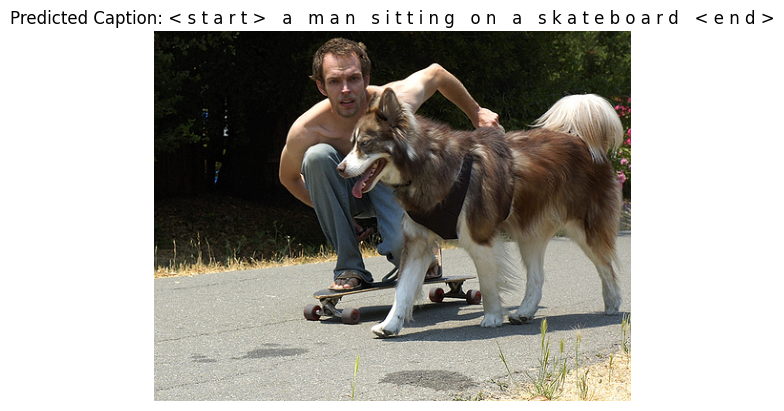

METEOR score for Image 13: 0.7433333333333335
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3186412658_2ab2ebd397
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3186412658_2ab2ebd397.jpg
Actual Caption: <start> group of woman hold each other up to catch ball <end>
Predicted_caption: <start> a group of women playing a game of rugby <end>


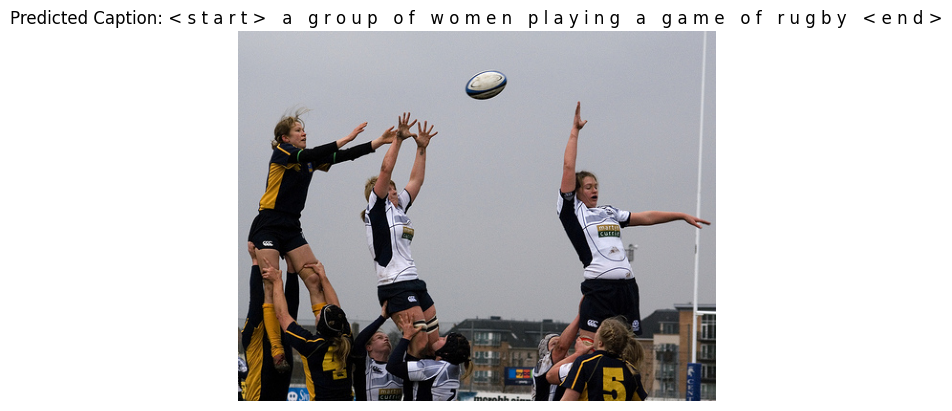

METEOR score for Image 14: 0.5175091233791442
BLEU score as percentage: 0.00%
------------------------------
Image ID: 109823397_e35154645f
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/109823397_e35154645f.jpg
Actual Caption: <start> person dressed in tan jacket jumps quad over <unk> <unk> in front of small out building <end>
Predicted_caption: <start> a man riding a quad quad quad quad quad quad quad quad quad quad quad quad quad quad quad <end>


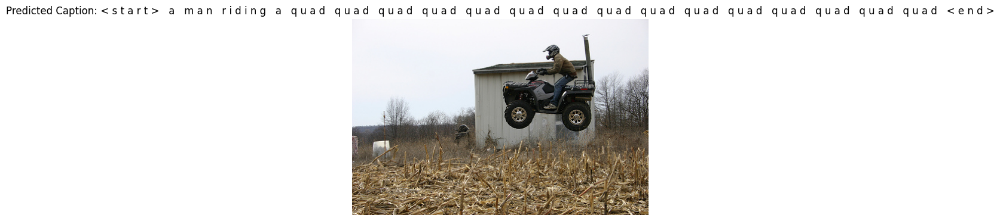

METEOR score for Image 15: 0.2210227720431801
BLEU score as percentage: 0.00%
------------------------------
Image ID: 344078103_4b23931ce5
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/344078103_4b23931ce5.jpg
Actual Caption: <start> two black dogs play in snow <end>
Predicted_caption: <start> two dogs playing in the snow <end>


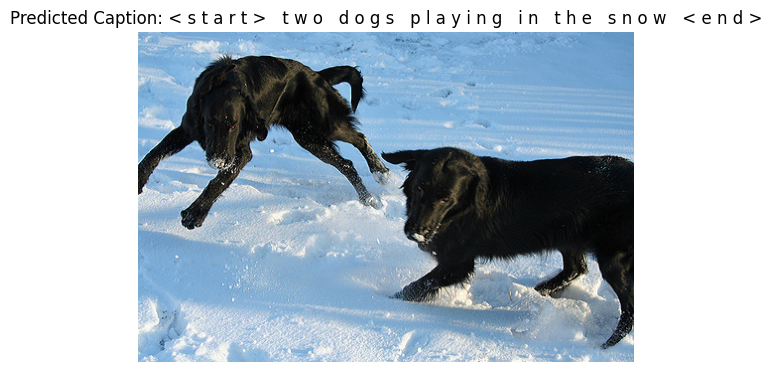

METEOR score for Image 16: 0.9073691460055096
BLEU score as percentage: 44.83%
------------------------------
Image ID: 263216826_acf868049c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/263216826_acf868049c.jpg
Actual Caption: <start> the couple is sitting on rock overlooking valley <end>
Predicted_caption: <start> a couple sitting on a rock <end>


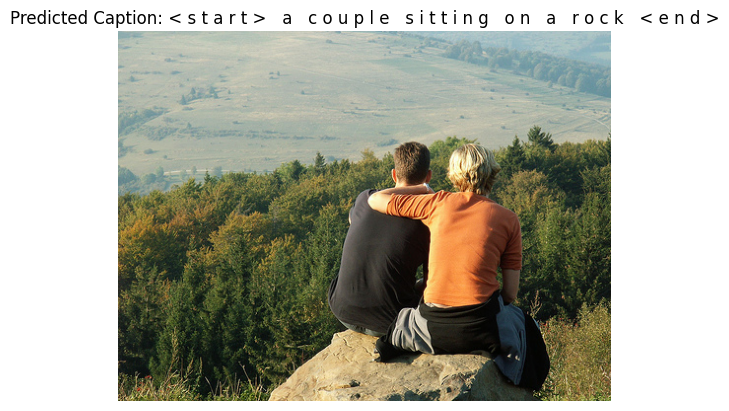

METEOR score for Image 17: 0.6793478260869565
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2050067751_22d2763fd2
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2050067751_22d2763fd2.jpg
Actual Caption: <start> the small child in green crocks leans over to look inside <unk> <end>
Predicted_caption: <start> a young boy is playing with a large puddle <end>


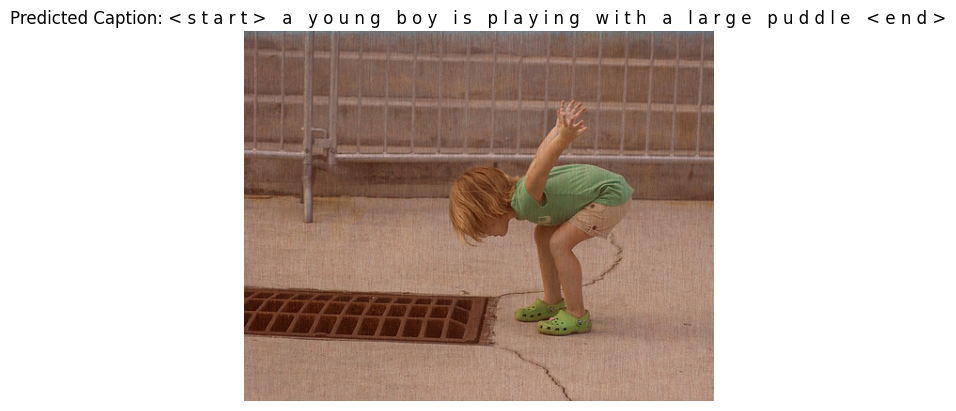

METEOR score for Image 18: 0.2621082621082621
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3583293892_c96af8cd98
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3583293892_c96af8cd98.jpg
Actual Caption: <start> baseball is being played by two men in red jerseys by <unk> sign <end>
Predicted_caption: <start> a baseball player throwing a ball on a baseball field <end>


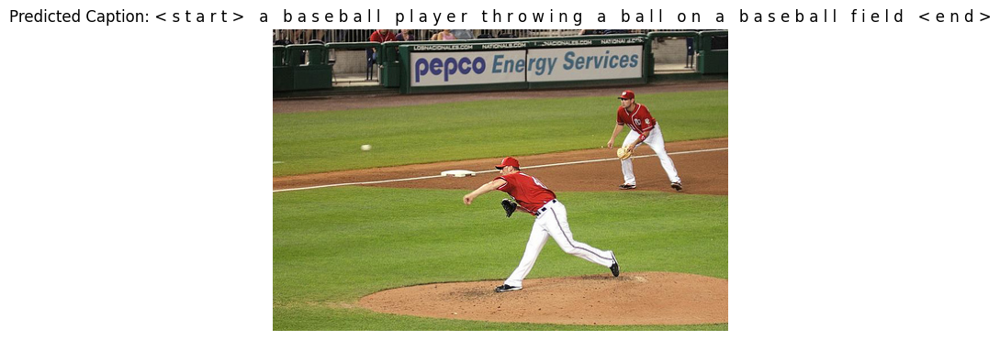

METEOR score for Image 19: 0.2792434046789447
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3530342993_a4a1f0e516
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3530342993_a4a1f0e516.jpg
Actual Caption: <start> bicycler is going down ramp at bike festival <end>
Predicted_caption: <start> a man on a bike <end>


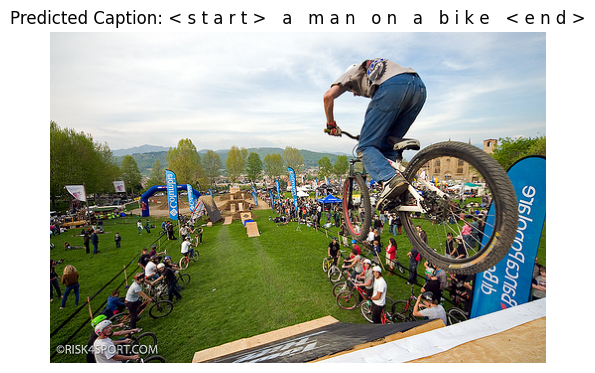

METEOR score for Image 20: 0.49083867123491726
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3709030554_02301229ea
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3709030554_02301229ea.jpg
Actual Caption: <start> young boy wearing red shirt runs along gravel road <end>
Predicted_caption: <start> a young boy running <end>


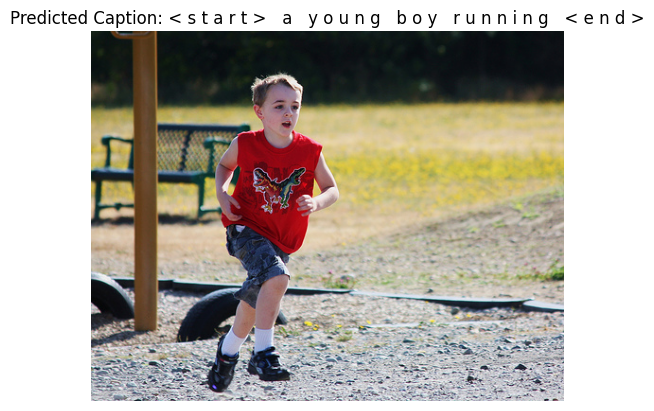

METEOR score for Image 21: 0.5934440187313751
BLEU score as percentage: 0.00%
------------------------------
Image ID: 1248734482_3038218f3b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1248734482_3038218f3b.jpg
Actual Caption: <start> young girl is laying in the grass posing for the camera <end>
Predicted_caption: <start> a girl laying on the grass <end>


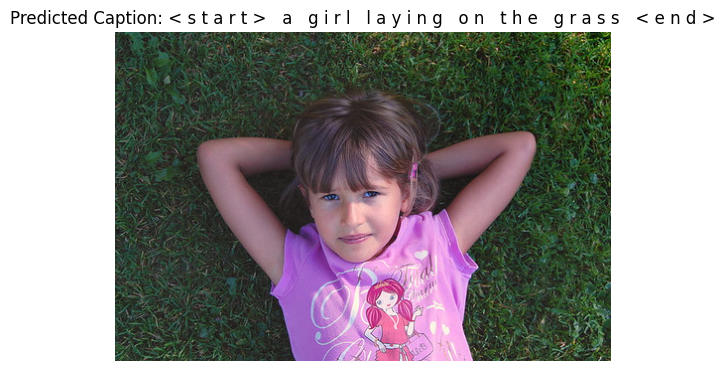

METEOR score for Image 22: 0.5406060606060606
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2815755985_0fa55544c0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2815755985_0fa55544c0.jpg
Actual Caption: <start> young girl laying on blue inflatable toy <end>
Predicted_caption: <start> a little girl laying on a blue inflatable <end>


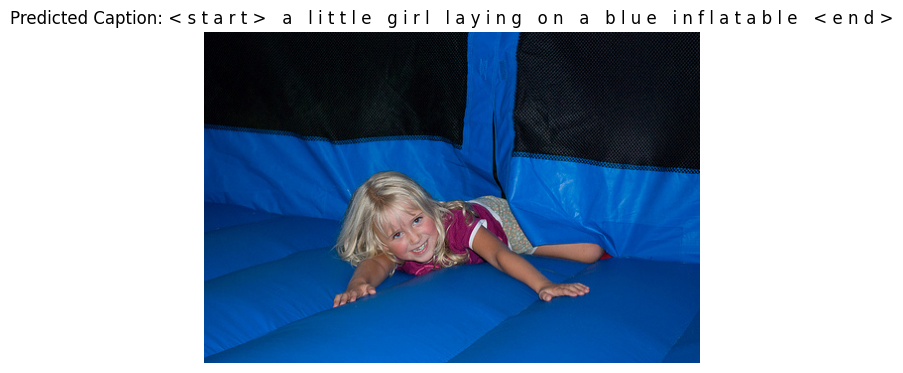

METEOR score for Image 23: 0.8195066557314995
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3655773435_c234e94820
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3655773435_c234e94820.jpg
Actual Caption: <start> dog in pool <end>
Predicted_caption: <start> a dog is swimming in a pool with a ball <end>


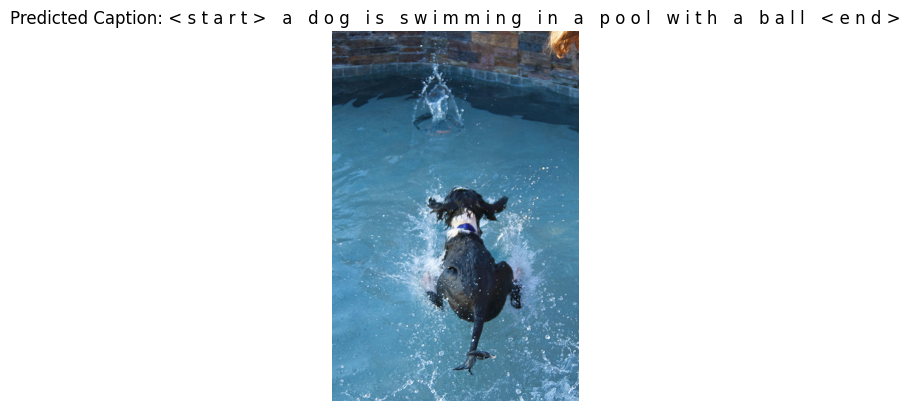

METEOR score for Image 24: 0.848288150693649
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3245070961_8977fdd548
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3245070961_8977fdd548.jpg
Actual Caption: <start> child in black shirt running <end>
Predicted_caption: <start> a boy running <end>


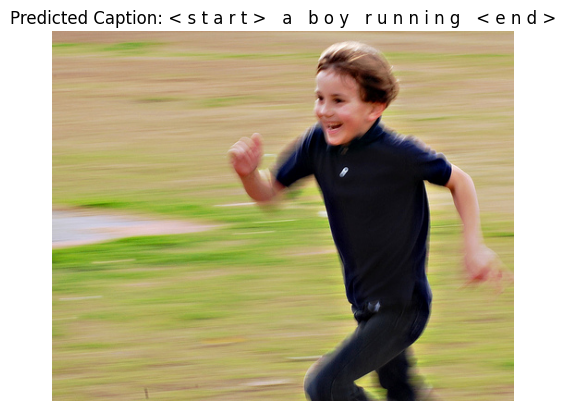

METEOR score for Image 25: 0.6405895691609977
BLEU score as percentage: 34.57%
------------------------------
Image ID: 3335692531_dd4a995f91
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3335692531_dd4a995f91.jpg
Actual Caption: <start> three dogs are all tugging on the same toy as they stand behind house <end>
Predicted_caption: <start> a dog and a dog <end>


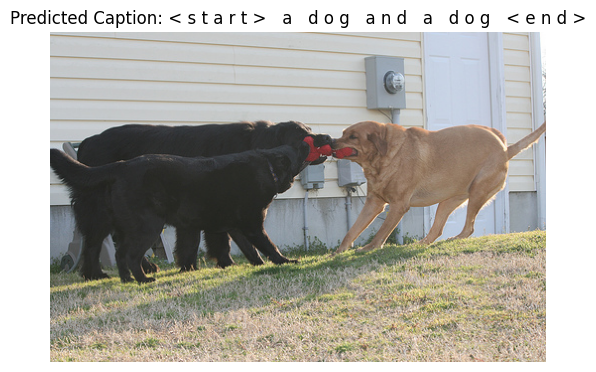

METEOR score for Image 26: 0.35206752858211343
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3367851138_757d6bd2ef
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3367851138_757d6bd2ef.jpg
Actual Caption: <start> boat docked at the harbor <end>
Predicted_caption: <start> a boat in the water <end>


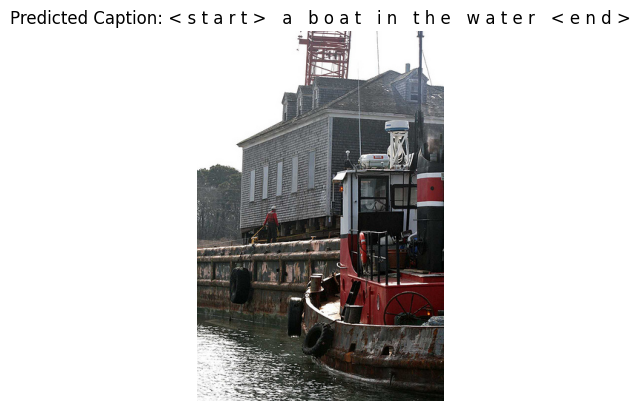

METEOR score for Image 27: 0.6818181818181819
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3587092143_c63030ed6d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3587092143_c63030ed6d.jpg
Actual Caption: <start> two men are kick boxing in kick boxing ring <end>
Predicted_caption: <start> a man wearing a white shirt <end>


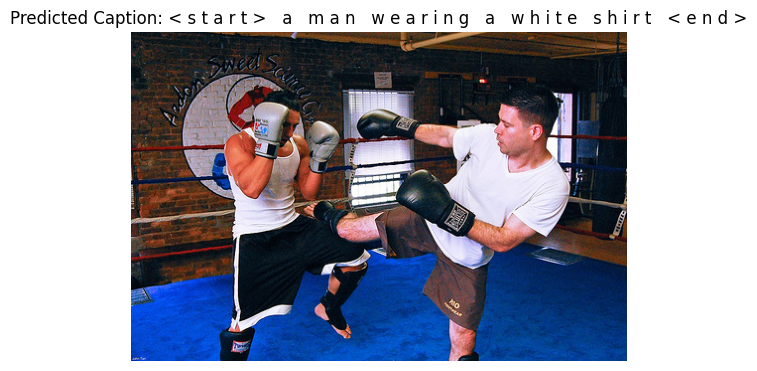

METEOR score for Image 28: 0.40060468631897206
BLEU score as percentage: 0.00%
------------------------------
Image ID: 1355945307_f9e01a9a05
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1355945307_f9e01a9a05.jpg
Actual Caption: <start> the red car has the number seven on the side in white circle <end>
Predicted_caption: <start> a red race car <end>


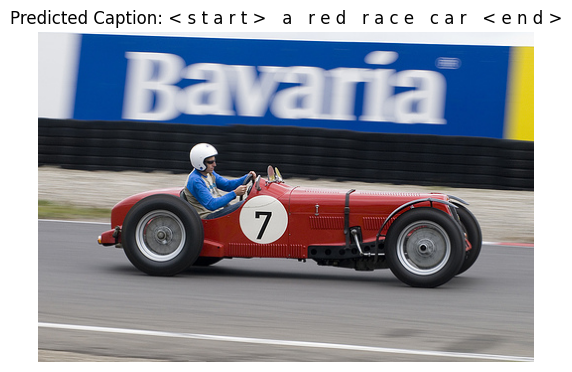

METEOR score for Image 29: 0.41436464088397784
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3185645793_49de805194
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3185645793_49de805194.jpg
Actual Caption: <start> mountain biker riding on hillside wearing helmet <end>
Predicted_caption: <start> a man riding a bike <end>


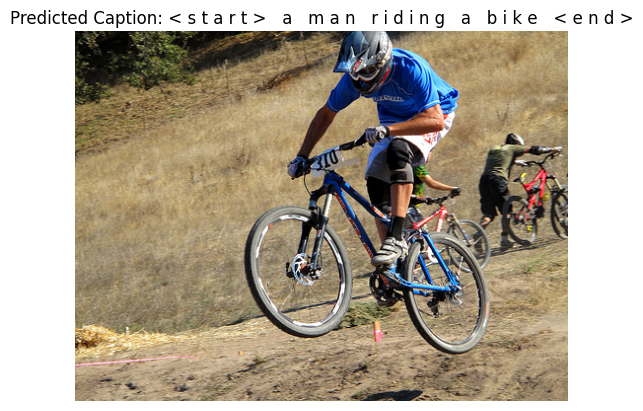

METEOR score for Image 30: 0.5253507653061225
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3530843182_35af2c821c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3530843182_35af2c821c.jpg
Actual Caption: <start> man with sunglasses on his head is looking at the woman with white hat and red scarf next to him whilst standing in front of red sports car <end>
Predicted_caption: <start> a man and woman <end>


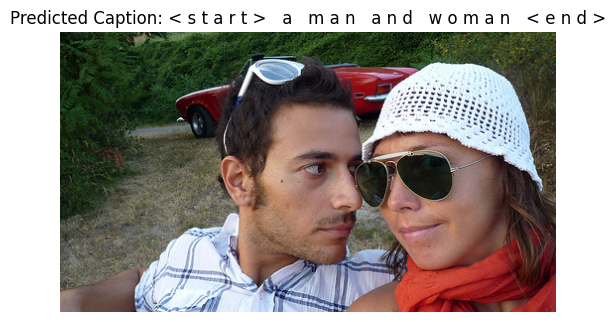

METEOR score for Image 31: 0.2603922487888733
BLEU score as percentage: 0.00%
------------------------------
Image ID: 240696675_7d05193aa0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/240696675_7d05193aa0.jpg
Actual Caption: <start> brown dog is running in grassy plain <end>
Predicted_caption: <start> a dog running through a field of tall grass <end>


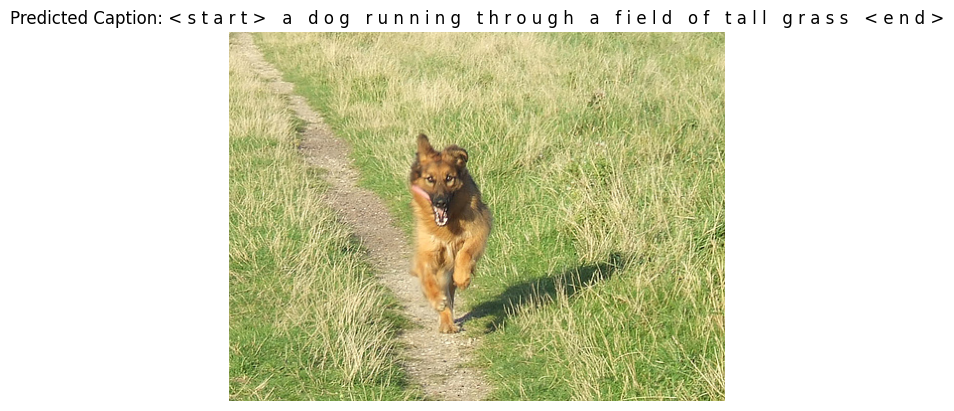

METEOR score for Image 32: 0.6233632622521511
BLEU score as percentage: 0.00%
------------------------------
Image ID: 287999021_998c2eeb91
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/287999021_998c2eeb91.jpg
Actual Caption: <start> two mountain climbers sit on mountain <end>
Predicted_caption: <start> two people on a mountain <end>


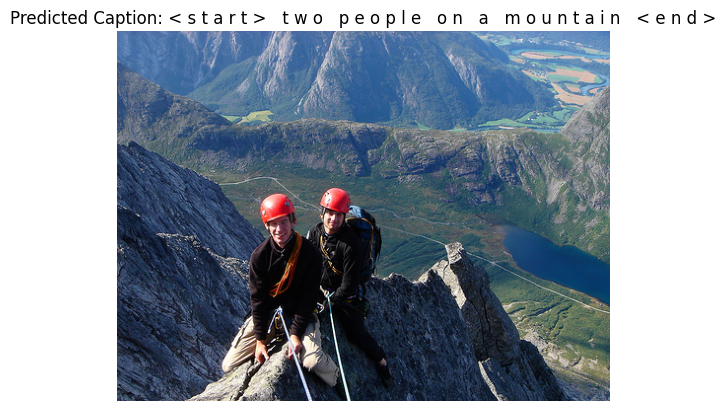

METEOR score for Image 33: 0.742296918767507
BLEU score as percentage: 44.13%
------------------------------
Image ID: 2710698257_2e4ca8dd44
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2710698257_2e4ca8dd44.jpg
Actual Caption: <start> man stands atop rocky cliff over the water <end>
Predicted_caption: <start> a man standing on a cliff <end>


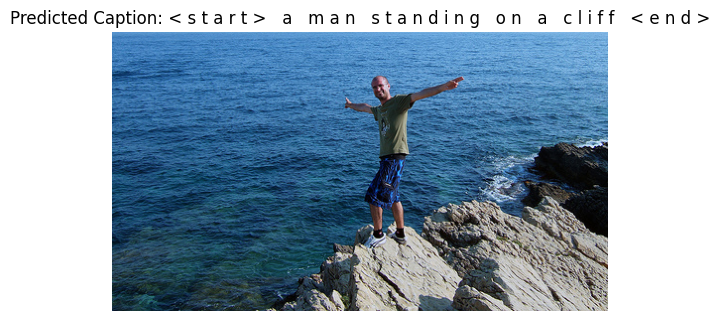

METEOR score for Image 34: 0.6235462515655753
BLEU score as percentage: 0.00%
------------------------------
Image ID: 143552697_af27e9acf5
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/143552697_af27e9acf5.jpg
Actual Caption: <start> man on motorcycle riding in dry field wearing helmet and backpack <end>
Predicted_caption: <start> a man riding a bike on a hill <end>


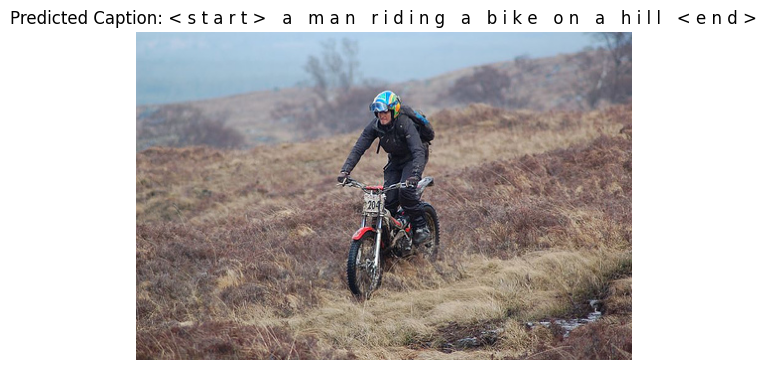

METEOR score for Image 35: 0.4927182671693649
BLEU score as percentage: 0.00%
------------------------------
Image ID: 431018958_84b2beebff
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/431018958_84b2beebff.jpg
Actual Caption: <start> girl pushing boat with pole in the water <end>
Predicted_caption: <start> a girl in a boat <end>


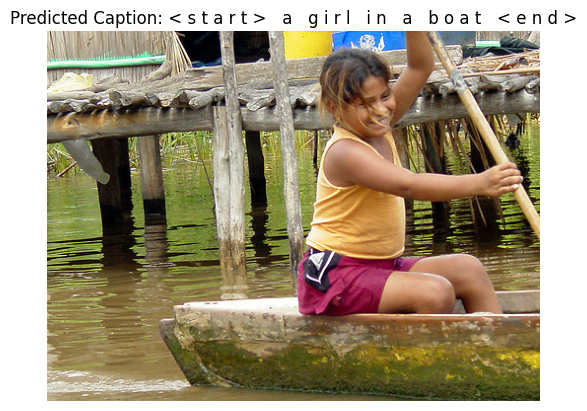

METEOR score for Image 36: 0.6006127782283501
BLEU score as percentage: 0.00%
------------------------------
Image ID: 842960985_91daf0d6ec
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/842960985_91daf0d6ec.jpg
Actual Caption: <start> man in tan trench coat and blue jeans walks with black umbrella open over his head <end>
Predicted_caption: <start> a man walking down the street with an umbrella <end>


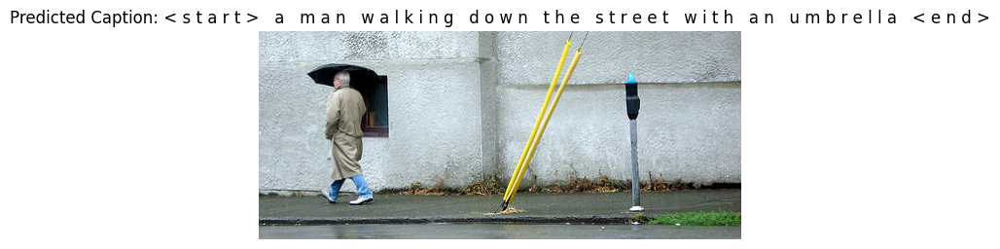

METEOR score for Image 37: 0.44988941915958564
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3315110972_1090d11728
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3315110972_1090d11728.jpg
Actual Caption: <start> white heron flies into the sky <end>
Predicted_caption: <start> a white bird flying over a body of water <end>


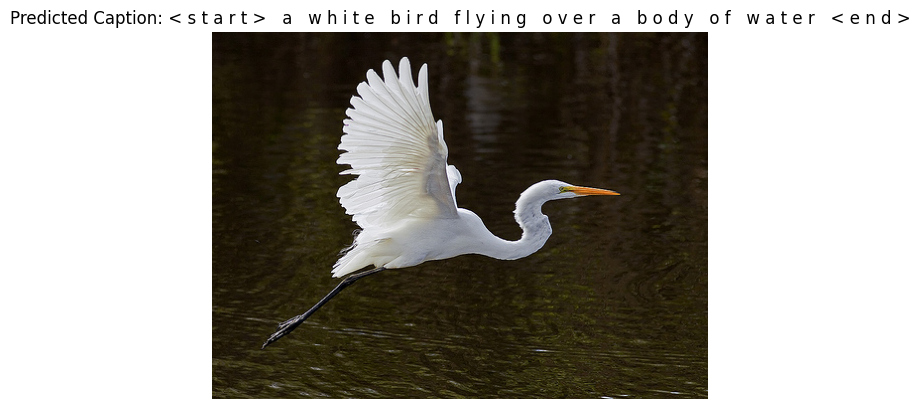

METEOR score for Image 38: 0.6097560975609756
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2043427251_83b746da8e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2043427251_83b746da8e.jpg
Actual Caption: <start> man jumping in mud puddle in the middle of the street <end>
Predicted_caption: <start> a man jumping in the water <end>


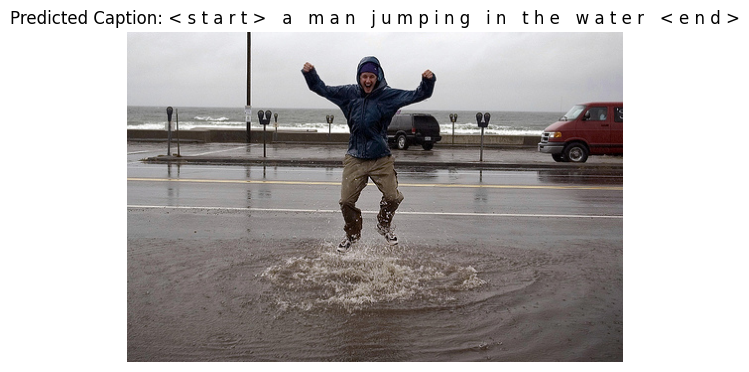

METEOR score for Image 39: 0.5681818181818182
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2922981282_203f04bf9b
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2922981282_203f04bf9b.jpg
Actual Caption: <start> young couple lying on bed together <end>
Predicted_caption: <start> a woman laying on a bed <end>


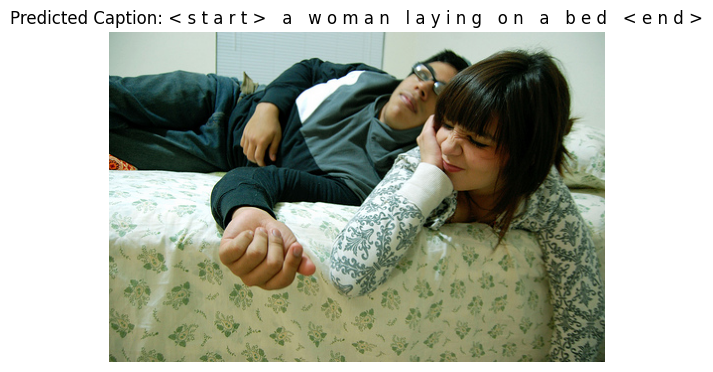

METEOR score for Image 40: 0.7170781893004116
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2839932205_3c9c27cd99
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2839932205_3c9c27cd99.jpg
Actual Caption: <start> person is climbing to the top of rock cliff <end>
Predicted_caption: <start> a clear blue sky <end>


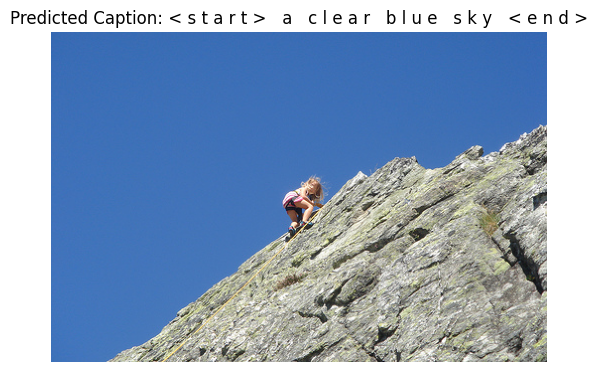

METEOR score for Image 41: 0.46375791695988744
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3544233095_4bca71df1d
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3544233095_4bca71df1d.jpg
Actual Caption: <start> child with green bucket on the beach <end>
Predicted_caption: <start> a cloudy sky <end>


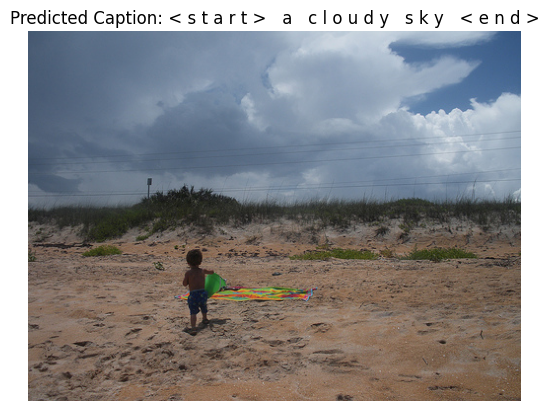

METEOR score for Image 42: 0.4673721340388008
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3585495069_33cba06d0a
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3585495069_33cba06d0a.jpg
Actual Caption: <start> group of kids playing dodgeball <end>
Predicted_caption: <start> a group of people playing a game of frc <end>


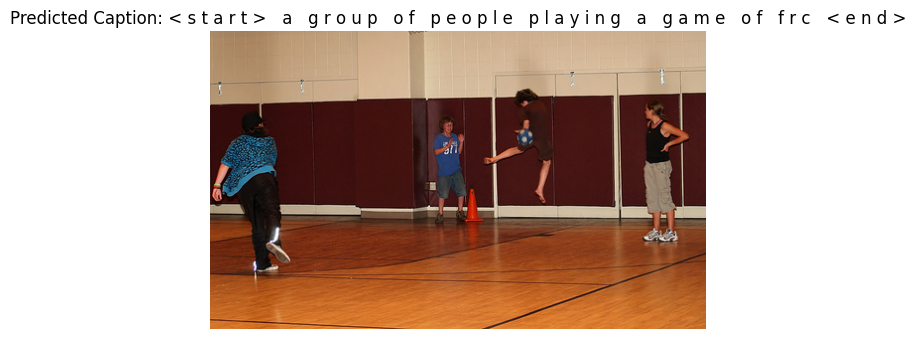

METEOR score for Image 43: 0.7217890405024908
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3601508034_5a3bfc905e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3601508034_5a3bfc905e.jpg
Actual Caption: <start> two men in different colored jerseys play hockey <end>
Predicted_caption: <start> two men playing a game of hurling <end>


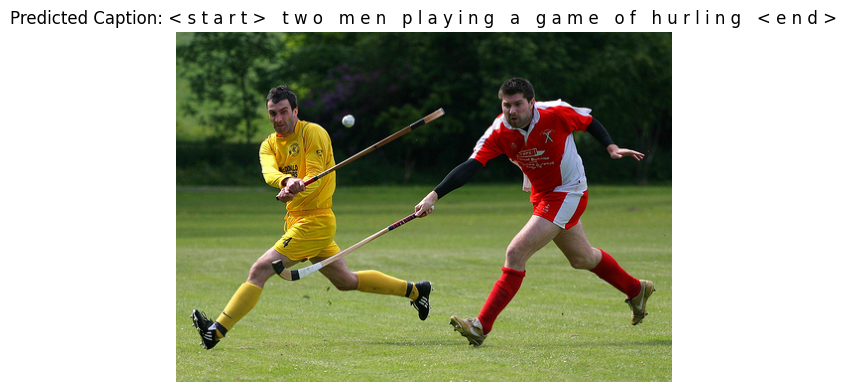

METEOR score for Image 44: 0.6354916067146283
BLEU score as percentage: 35.81%
------------------------------
Image ID: 3030824089_e5a840265e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3030824089_e5a840265e.jpg
Actual Caption: <start> black and tan dog leaps over the green grass <end>
Predicted_caption: <start> a dog running in the grass <end>


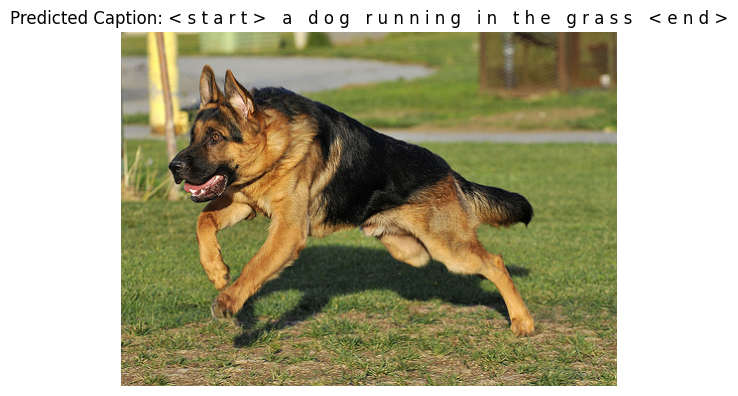

METEOR score for Image 45: 0.5853699504493155
BLEU score as percentage: 25.43%
------------------------------
Image ID: 3085667767_66041b202e
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3085667767_66041b202e.jpg
Actual Caption: <start> surfer is flipping up in the air on surfboard <end>
Predicted_caption: <start> a man surfing in the ocean <end>


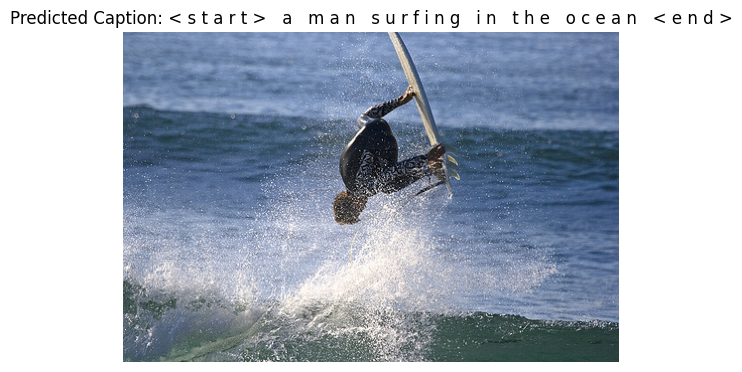

METEOR score for Image 46: 0.5853699504493155
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2848571082_26454cb981
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2848571082_26454cb981.jpg
Actual Caption: <start> black dog jumps to catch ball in yard <end>
Predicted_caption: <start> a dog catching a frurd ball in a yard <end>


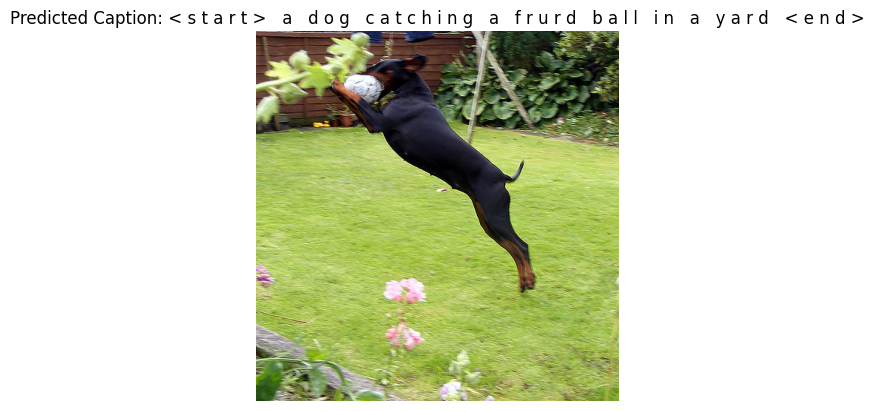

METEOR score for Image 47: 0.7435085868354728
BLEU score as percentage: 27.23%
------------------------------
Image ID: 1286408831_05282582ed
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/1286408831_05282582ed.jpg
Actual Caption: <start> boy with his mouth open and tongue sticking out clinging to bar next to platform <end>
Predicted_caption: <start> a young boy is playing with a toy <end>


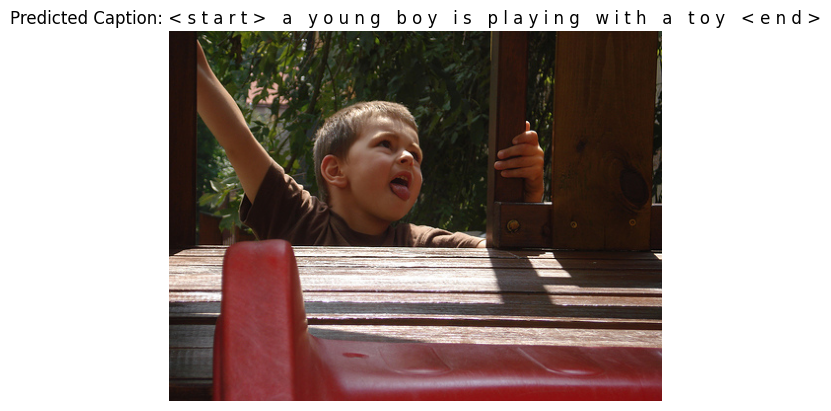

METEOR score for Image 48: 0.3694581280788177
BLEU score as percentage: 0.00%
------------------------------
Image ID: 2557972410_6925fe695c
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/2557972410_6925fe695c.jpg
Actual Caption: <start> several players playing game of hockey outside on the road <end>
Predicted_caption: <start> a person wearing a helmet <end>


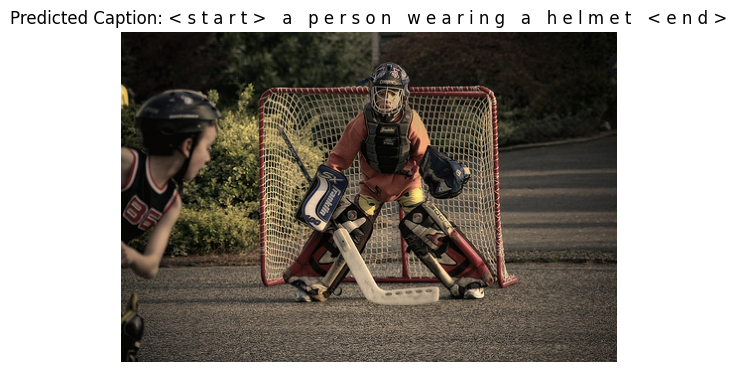

METEOR score for Image 49: 0.3799283154121863
BLEU score as percentage: 0.00%
------------------------------
Image ID: 3470303255_fbb41b8dd0
Image Path: /content/drive/MyDrive/attention_model/Flicker8k_Dataset/3470303255_fbb41b8dd0.jpg
Actual Caption: <start> little girl with knit cap smelling flowers <end>
Predicted_caption: <start> a little girl in a pink hat <end>


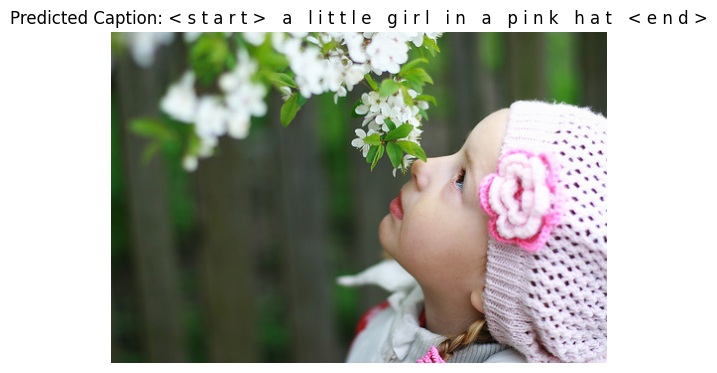

METEOR score for Image 50: 0.5991586538461539
BLEU score as percentage: 0.00%
------------------------------
Average METEOR score for all images: 0.5591500576427856
Average BLEU score for all images: 0.0719248681028937


In [21]:
# Initialize lists to store individual BLEU and METEOR scores for each image
individual_bleu_scores = []
individual_meteor_scores = []

# Define the number of images to test and get the test DataFrame
num_images_to_test = 50
test_df = random_testimage_df.head(num_images_to_test)

# Loop through each row of the DataFrame
for index, row in test_df.iterrows():
    image_id = row['Image_ID']
    image_path = row['Image_Path']
    actual_caption = row['Actual_Caption']

    # Print image information
    print(f"Image ID: {image_id}")
    print(f"Image Path: {image_path}")
    print(f"Actual Caption: {actual_caption}")

    # Load the image using PIL
    img = Image.open(image_path)

    # Perform image-to-text captioning
    result = image_caption(img)
    predicted_caption = result[0]['generated_text']  # Extract the generated_text from the dictionary

    # Add <start> and <end> tokens to the predicted caption
    #predicted_caption_tokens = ['<start>'] + word_tokenize(predicted_caption.lower()) + ['<end>']
    # Tokenize the reference caption and convert to lowercase
    actual_tokens = word_tokenize(actual_caption.lower())
    predicted_caption_token = ['<start>'] + word_tokenize(predicted_caption) + ['<end>']
    actual_caption_str = actual_caption
    predicted_caption_str = ' '.join(predicted_caption_token)
    print('Predicted_caption:', predicted_caption_str)

    # Tokenize the hypothesis and reference captions
    predicted_tokens = word_tokenize(predicted_caption_str.lower())
    actual_tokens = word_tokenize(actual_caption_str.lower())
    # Calculate the METEOR score for the current image
    score = meteor_score.meteor_score([actual_tokens], predicted_tokens)  # Use meteor_score.meteor_score
    individual_meteor_scores.append(score)


    # Calculate the BLEU score for the current image
    bleu_score = sentence_bleu([actual_tokens], predicted_tokens)
    individual_bleu_scores.append(bleu_score)

    # Display the image
    img = Image.open(image_path)
    plt.imshow(img)
    plt.title("Predicted Caption: " + ' '.join(predicted_caption_str))  # Use predicted_caption_tokenized
    plt.axis('off')
    plt.show()

    # Print the METEOR and BLEU scores for the current image
    print(f"METEOR score for Image {index+1}: {score}")
    bleu_percentage = bleu_score * 100
    print(f"BLEU score as percentage: {bleu_percentage:.2f}%")
    print("------------------------------")

# ... (rest of the code)

# Calculate the average METEOR score for all images
average_meteor_score = sum(individual_meteor_scores) / len(individual_meteor_scores)

# Calculate the average BLEU score for all images
average_bleu_score = sum(individual_bleu_scores) / len(individual_bleu_scores)

# Print the average METEOR and BLEU scores
print(f"Average METEOR score for all images: {average_meteor_score}")
print(f"Average BLEU score for all images: {average_bleu_score}")
